In [59]:
import rasterio as rs
from rasterio.plot import show

import io
from PIL import Image

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

## Data is taken from Research study (Aug 2019)
---
**Annual oil palm plantation maps in Malaysia and Indonesia from 2001 to 2016**

*(Yidi Xu; Le Yu; Wei Li; Philippe Ciais; Yuqi Cheng; Peng Gong)*

This dataset contains the annual oil palm maps for Malaysia and Indonesia from 2001 to 2016 at 100 resolution with both oil palm expansion and shrinkage (bi-directional). 

Web link (https://zenodo.org/record/3467071#.X515sohKgow)


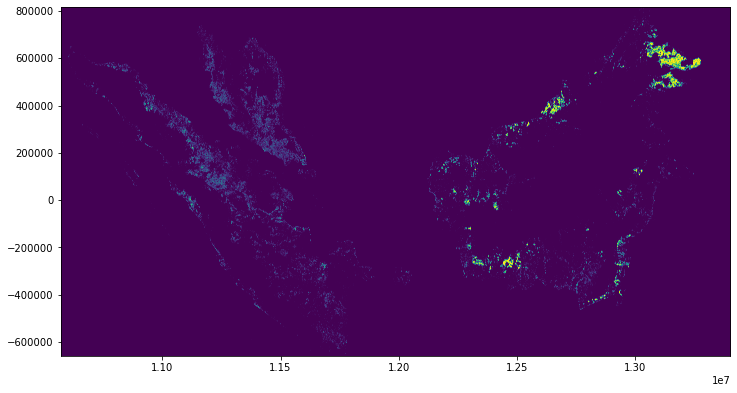

<AxesSubplot:>

In [77]:
# Examine 2001 data
fig, ax = plt.subplots(1, figsize=(12,12))

read = r'2001_op_lower.tif'  # If data in same folder (trial)
tif01 = rs.open(read)
show(tif01)

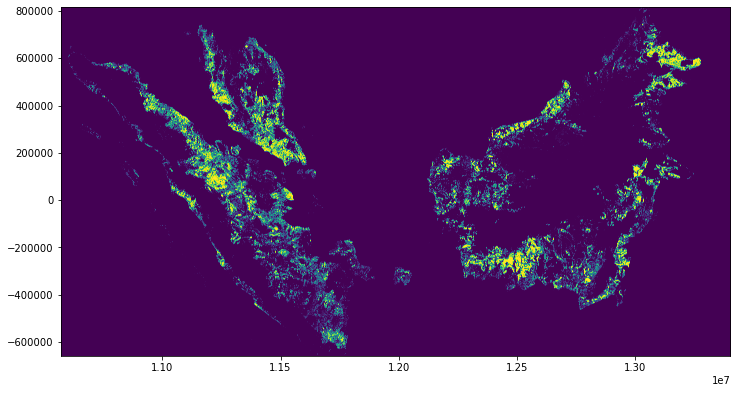

<AxesSubplot:>

In [79]:
# Examine 2016 data
fig, ax = plt.subplots(1, figsize=(12,12))

read = r'/Users/louischua53/Oil_palm/lower/2016_op.tif'  # read from path 
tif16 = rs.open(read)
show(tif16)

## Attempt to plot on Folium interactive map

In [78]:
from osgeo import gdal

In [80]:
ds = gdal.Open(read)    # open read file
myarray = np.array(ds.GetRasterBand(1).ReadAsArray())    # convert file to np array
im = Image.fromarray(myarray)    # then convert it back into .png
im.save("tif.png")

In [95]:
# Get bottom left, top right box coordinates

tif01.bounds

BoundingBox(left=10570443.310357241, bottom=-658199.4102881479, right=13403343.310357241, top=816500.5897118521)

In [87]:
m = folium.Map(location=[0.0263, 109.3425],
               tiles='cartodbpositron',
               zoom_start=5)

rasterlayer = folium.FeatureGroup(name="raster")
rasterlayer.add_child(folium.raster_layers.ImageOverlay(image = "tif.png", bounds = [[-658199.4102881479, 10570443.310357241],[816500.5897118521, 13403343.310357241]],
                                                       interactive=True))
m.add_child(rasterlayer)
m.add_child(folium.LayerControl())
m

# Does not work

### Dataset Attributes

In [4]:
# Check no. of bands
# All band arrays have same no. of columns and rows

tif01.count

# Or use <tif01.indexes>

1

In [5]:
tif01.shape

(14747, 28329)

In [6]:
print(tif01.width, tif01.height)

28329 14747


In [35]:
tif01.crs.data

{'proj': 'merc',
 'lon_0': 0,
 'k': 1,
 'x_0': 0,
 'y_0': 0,
 'datum': 'WGS84',
 'units': 'm',
 'no_defs': True}

In [7]:
tif01.meta

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 28329,
 'height': 14747,
 'count': 1,
 'crs': CRS.from_wkt('PROJCS["WGS_1984_World_Mercator",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Mercator_1SP"],PARAMETER["central_meridian",0],PARAMETER["scale_factor",1],PARAMETER["false_easting",0],PARAMETER["false_northing",0],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]'),
 'transform': Affine(100.0, 0.0, 10570443.310357241,
        0.0, -100.0, 816500.5897118521)}

In [16]:
tif01.bounds

BoundingBox(left=10570443.310357241, bottom=-658199.4102881479, right=13403343.310357241, top=816500.5897118521)

## Try GeoTiff to PNG method

In [17]:
import rasterio
from rasterio.mask import mask

In [44]:
# Get the polygon GeoJSON Geometry

geoms = [{'type': 'Polygon', 'coordinates': [[[10570443.310357, 816500.589712], [10570443.310357, -658199.410288], [13403343.310357, -658199.410288], [13403343.310357, 816500.589712], [10570443.310357, 816500.589712]]]}]

# Load raster, mask it by polygon and don't crop it

with rs.open("2001_op_lower.tif") as src:
    out_image, out_transform = mask (src, geoms, crop=False)
    
out_meta = src.meta.copy()

In [51]:
# Save resulting raster as png

out_meta.update({"driver": "PNG",
               "height": out_image.shape[1],
               "width": out_image.shape[2],
               "transform": out_transform})

In [52]:
with rs.open("masked.png", "w", **out_meta) as dst:
    dst.write(out_image)

In [53]:
out_meta

{'driver': 'PNG',
 'dtype': 'uint8',
 'nodata': None,
 'width': 28329,
 'height': 14747,
 'count': 1,
 'crs': CRS.from_wkt('PROJCS["WGS_1984_World_Mercator",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Mercator_1SP"],PARAMETER["central_meridian",0],PARAMETER["scale_factor",1],PARAMETER["false_easting",0],PARAMETER["false_northing",0],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]'),
 'transform': Affine(100.0, 0.0, 10570443.310357241,
        0.0, -100.0, 816500.5897118521)}

## Extract GeoJSON shape from raster data footprint

In [8]:
import rasterio.features
import rasterio.warp
import rasterio.windows
import rasterio.plot as plot

import numpy as np

In [14]:
mask = tif01.dataset_mask()

for geom, val in rasterio.features.shapes(mask, transform= tif01.transform):
    geom = rasterio.warp.transform_geom(tif01.crs, 'EPSG:3395', geom, precision=6)
    print(geom)

{'type': 'Polygon', 'coordinates': [[[10570443.310357, 816500.589712], [10570443.310357, -658199.410288], [13403343.310357, -658199.410288], [13403343.310357, 816500.589712], [10570443.310357, 816500.589712]]]}


In [15]:
mask

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)

In [32]:
#transform, width, height = rasterio.warp.calculate_default_transform(tif01.crs, {"init":"epsg:4326"},tif01.shape[1], tif01.shape[0], left=tif01.bounds[0],bottom=tif01.bounds[1], right=tif01.bounds[2],top= tif01.bounds[3])

In [33]:
#outarray = np.ndarray((height, width))

In [34]:
#plot.show(outarray, transform=transform)

### Calculate percentage increase in Oil Palm areas

In [9]:
op01 = tif01.read(1).sum()

In [10]:
op16 = tif16.read(1).sum()

In [11]:
# Across Malaysia and Indonesia, oil palm plantation area increased ~379%, or 3.8 times from 2001 to 2016

((op16-op01)/op01)*100

379.3087338146708

### Overlay Raster onto Basemap

In [30]:
src.bounds

BoundingBox(left=10570443.310357241, bottom=-658199.4102881479, right=13403343.310357241, top=816500.5897118521)

In [68]:
import os
img = os.path.abspath("tif16.png")


In [89]:
m = folium.Map(location=[0.0263, 109.3425],
               tiles='cartodbpositron',
               zoom_start=5)

#folium.raster_layers.ImageOverlay(image= geom, opacity=5, bounds= [[95.2930261576, -10.3599874813], [141.03385176, 5.47982086834]]).add_to(m)

# Indonesia bounding box ([95.2930261576, -10.3599874813], [141.03385176, 5.47982086834])
# Malaysia bounding box ([100.085756871, 0.773131415201], [119.181903925, 6.92805288332])

folium.raster_layers.ImageOverlay(image= "tif.png",bounds= [[-658199.4102881479, 10570443.310357241],[816500.5897118521, 13403343.310357241]]).add_to(m)

#layer = folium.GeoJson(data=out_meta,name='geojson').add_to(m)

m

#m.fit_bounds(layer.get_bounds())   # fit map to GeoJSON layer